In [1]:
# https://www.kaggle.com/code/frizmoo/eda-time-series-bike-sharing

In [2]:
import pandas as pd
from summarytools import dfSummary
from ydata_profiling import ProfileReport
import sidetable
import seaborn as sns
from scipy.stats import norm
import matplotlib.pyplot as plt
import numpy as np
import sweetviz as sv
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from phik.report import plot_correlation_matrix
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.linear_model import LinearRegression, HuberRegressor
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn.neural_network import MLPRegressor
import statsmodels.api as sm
import scipy.stats as stats
from sklearn.svm import SVR
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from sklearn.metrics import silhouette_score
import warnings
warnings.filterwarnings("ignore")

In [3]:
day_df = pd.read_csv('day.csv')

In [4]:
hour_df = pd.read_csv('hour.csv')

In [5]:
day_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 731 entries, 0 to 730
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   instant     731 non-null    int64  
 1   dteday      731 non-null    object 
 2   season      731 non-null    int64  
 3   yr          731 non-null    int64  
 4   mnth        731 non-null    int64  
 5   holiday     731 non-null    int64  
 6   weekday     731 non-null    int64  
 7   workingday  731 non-null    int64  
 8   weathersit  731 non-null    int64  
 9   temp        731 non-null    float64
 10  atemp       731 non-null    float64
 11  hum         731 non-null    float64
 12  windspeed   731 non-null    float64
 13  casual      731 non-null    int64  
 14  registered  731 non-null    int64  
 15  cnt         731 non-null    int64  
dtypes: float64(4), int64(11), object(1)
memory usage: 91.5+ KB


In [6]:
hour_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 17 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   instant     17379 non-null  int64  
 1   dteday      17379 non-null  object 
 2   season      17379 non-null  int64  
 3   yr          17379 non-null  int64  
 4   mnth        17379 non-null  int64  
 5   hr          17379 non-null  int64  
 6   holiday     17379 non-null  int64  
 7   weekday     17379 non-null  int64  
 8   workingday  17379 non-null  int64  
 9   weathersit  17379 non-null  int64  
 10  temp        17379 non-null  float64
 11  atemp       17379 non-null  float64
 12  hum         17379 non-null  float64
 13  windspeed   17379 non-null  float64
 14  casual      17379 non-null  int64  
 15  registered  17379 non-null  int64  
 16  cnt         17379 non-null  int64  
dtypes: float64(4), int64(12), object(1)
memory usage: 2.3+ MB


In [7]:
dfSummary(day_df)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,instant[int64],Mean (sd) : 366.0 (211.2)min < med < max:1.0 < 366.0 < 731.0IQR (CV) : 365.0 (1.7),731 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKQAAABACAYAAACUYNzVAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAABbElEQVR4nO3XsU7CUACF4db0JqIJJU59H5/ADZ6Q0YdiYTFYg+JkXRwYEAQGjuT7Foab03b4U6AehqGCFDeXfgDY1lz6Afh/6rq+qapqfMYl3oZh+Np18GuQZ960/vk85feAbf62nU6nj5PJ5OPYYd/3o/l8/lxV1euu831vyPFsNntq23Zz7E0Xi8VDKaXuuu7F9jq3TdN8dl33fuz2kL1f2W3bbk656Wq1uiulVLbXuz1281f+1BBFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESpdl32Pf96JSLrtfr21JKvVwu721ttx1q6hsQT6CLQq4mrwAAAABJRU5ErkJggg=="">",0(0.0%)
2,dteday[object],1. 2011-01-012. 2012-04-253. 2012-04-274. 2012-04-285. 2012-04-296. 2012-04-307. 2012-05-018. 2012-05-029. 2012-05-0310. 2012-05-0411. other,1 (0.1%)1 (0.1%)1 (0.1%)1 (0.1%)1 (0.1%)1 (0.1%)1 (0.1%)1 (0.1%)1 (0.1%)1 (0.1%)721 (98.6%),"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAJsAAAD+CAYAAAAtWHdlAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAAC/UlEQVR4nO3cMW7CQBRF0TGioTIl20rJCimztRgpomPSZgXXkjlnBVNcPbngs8w5BxROez+AzyE2MmIjIzYyYiMjNjJiIyM2MmIjIzYyp2VZrns/gs9g2ciIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjILP5YhoplIyM2MmIj47qKjGUjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjIOXshYNjJiIyM2Mg5eyFg2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiPj4IWMZSMjNjJiIyM2Mq6ryFg2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiPjuoqMZSMjNjJiI+PghYxlIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyDl7IWDYyYiMjNjIOXshYNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyrqvIWDYyYiMjNjKuq8hYNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIj4+CFjGUjIzYyYiPj4IWMZSMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2Mg5eyFg2MmIjIzYyYiPjuoqMZSMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2Mq6ryFg2MmIjIzYyDl7IWDYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiI+PghYxlIyM2MssY47r3Izi855zzfb7f71/rur72fg3HtG3b5fF4fI8xfs7rur5ut9vv3o/i+HyzkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbmfO2bZe9H8Fx/e/LL3UpPOecb9dVZHyzkREbGbGRERsZsZERGxmxkREbGbGRERuZP5cTQZK9ZvyZAAAAAElFTkSuQmCC"">",0(0.0%)
3,season[int64],Mean (sd) : 2.5 (1.1)min < med < max:1.0 < 3.0 < 4.0IQR (CV) : 1.0 (2.2),4 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKQAAABACAYAAACUYNzVAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAABR0lEQVR4nO3YO07DQBRAUTuiocFttkWZFaZkaxgJ0WEaCgoSCfLxJZzTWh4/aa7GlsdlWQao2Kw9AHx1t/YA/904jpthGB5OWOJlWZb3c82ztpsK8o9u7sNut3ucpuntpzfO83y/3++fhmF4Pv9Y6zgYpM29nmma3rbb7eu1n1t07IS0uXzrkofV0Ve2zeWAix1WN/UNyfVc6rDy24cUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIk5e7YxXme73+z6Od90ziOvxrqBJOZr+LUmQ/6AI2vXEoQ/+bGAAAAAElFTkSuQmCC"">",0(0.0%)
4,yr[int64],Mean (sd) : 0.5 (0.5)min < med < max:0.0 < 1.0 < 1.0IQR (CV) : 1.0 (1.0),2 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKQAAABACAYAAACUYNzVAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAABL0lEQVR4nO3WsU4CQRRA0VlCQ8O2/JYlX0jpr7kmhs61sbCBBAjxas5pX97MFLeYaV3XARWb334A/LS9NJimaTPG2D9w9vu6rp8P7BP1zDYuBjnG2B+Px5d5ns+33rYsy+50Or2OMd5u3eVPeFob14Ic8zyfD4fDx62X8v89qw1/SFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIESYogSREkKYIkRZCkCJIUQZIiSFIEScr22nBZlt09h37vzdM03fUo8uYH27joC7BeL9Qc+gzHAAAAAElFTkSuQmCC"">",0(0.0%)
5,mnth[int64],Mean (sd) : 

In [8]:
dfSummary(hour_df)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,instant[int64],Mean (sd) : 8690.0 (5017.0)min < med < max:1.0 < 8690.0 < 17379.0IQR (CV) : 8689.0 (1.7),"17,379 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKQAAABACAYAAACUYNzVAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAABUklEQVR4nO3WsUrDUBTH4ZPSC1ahAae8lmOfsKMP1aWL1Eilm3FxyNBW2sU/8n1LhsO5N8OPkG6apoIUi79+AZhbXhp0XbeoqvWd53Y/z3s+v3b/925V1cc0TV/nBheDrKr1ZrN56fv+dOttu93uubXWDcPwZtfu3DiOq+12+1pV7+fm14Ksvu9PwzB83nrp4XB4bK2VXbu38g9JFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEmV5bTiO4+qeQ4/H40Nrrdvv90927c791tQ3ucefRh4PyjAAAAAASUVORK5CYII="">",0(0.0%)
2,dteday[object],1. 2011-01-012. 2012-04-033. 2012-04-284. 2012-04-295. 2012-04-306. 2012-05-017. 2012-05-028. 2012-05-039. 2012-05-0410. 2012-05-0511. other,"24 (0.1%)24 (0.1%)24 (0.1%)24 (0.1%)24 (0.1%)24 (0.1%)24 (0.1%)24 (0.1%)24 (0.1%)24 (0.1%)17,139 (98.6%)","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAJsAAAD+CAYAAAAtWHdlAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAAC/UlEQVR4nO3cMW7CQBRF0TGioTIl20rJCimztRgpomPSZgXXkjlnBVNcPbngs8w5BxROez+AzyE2MmIjIzYyYiMjNjJiIyM2MmIjIzYyp2VZrns/gs9g2ciIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjILP5YhoplIyM2MmIj47qKjGUjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjIOXshYNjJiIyM2Mg5eyFg2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiPj4IWMZSMjNjJiIyM2Mq6ryFg2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiPjuoqMZSMjNjJiI+PghYxlIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyDl7IWDYyYiMjNjIOXshYNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyrqvIWDYyYiMjNjKuq8hYNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIj4+CFjGUjIzYyYiPj4IWMZSMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2Mg5eyFg2MmIjIzYyYiPjuoqMZSMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2Mq6ryFg2MmIjIzYyDl7IWDYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiI+PghYxlIyM2MssY47r3Izi855zzfb7f71/rur72fg3HtG3b5fF4fI8xfs7rur5ut9vv3o/i+HyzkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkREbmfO2bZe9H8Fx/e/LL3UpPOecb9dVZHyzkREbGbGRERsZsZERGxmxkREbGbGRERuZP5cTQZK9ZvyZAAAAAElFTkSuQmCC"">",0(0.0%)
3,season[int64],Mean (sd) : 2.5 (1.1)min < med < max:1.0 < 3.0 < 4.0IQR (CV) : 1.0 (2.3),4 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKQAAABACAYAAACUYNzVAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAABUElEQVR4nO3YMW7CQBRF0RlEQ8O0bCulV0iZrcWREF0mTYo0WApg/Oyc0yLbX5qrb4vaey+QYrf0APDbfukB/rta666UcnzgFp+9969nzbO0TQW50sM9DsPw1lq7/vXCcRwP5/P5vZTy8fyxlrGpIMtKD7e1dj2dTpdXPzfRzSBXum0c7spNbchVbhvmN+eymnxl2zbcMNuy2to3JC8y17LyPyRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESRRBEkWQRBEkUQRJFEESRZBEESRRBEkUQRJFkEQRJFEESZT91I/jOB7uuenPda3WetdQD2hmfolHZ77pG6CkXEyEtXU4AAAAAElFTkSuQmCC"">",0(0.0%)
4,yr[int64],Mean (sd) : 0.5 (0.5)min < med < max:0.0 < 1.0 < 1.0IQR (CV) : 1.0 (1.0),2 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKQAAABACAYAAACUYNzVAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAABMklEQVR4nO3XsU4CQRRA0V1DQ8O0/JYlX0jpr7kmhs61sbAAElHiJTmnncy8KW5ms/O6rhNUPP33BeC7zX9fgMczz/PTNE27Xxzxtq7rx7mFi0HecygPb3c4HJ7HGKefblyWZXs8Hl+maXo9t37thbzbUB7fGOO03+/f//rcq5/sew2FS/zUkCJIUgRJiiBJESQpgiRFkKQIkhRBkiJIUgRJiiBJESQpgiRFkKQIkhRBkiJIUgRJiiBJESQpgiRFkKQIkhRBkiJIUgRJiiBJESQpgiRFkKQIkhRBkiJIUgRJiiBJESQpgiRFkKQIkhRBkiJIUgRJiiBJESQpgiRFkKQIkhRBkiJIUgRJiiBJESQpgiRFkKQIkhRBkrK5trgsy/aWQ7/2jXmeb7oUeeOXbVz0Cdj+L9ZIAT9LAAAAAElFTkSuQmCC"">",0(0.0%)
5,mnth[int64],Mean (

In [9]:
profile_day = ProfileReport(day_df, title="Day DF Report")
profile_hour = ProfileReport(hour_df, title="Hour DF Report")

In [10]:
profile_day.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
profile_hour.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## EDA FOR DAY DF

In [12]:
day_df.dteday = pd.to_datetime(day_df.dteday)
day_df.set_index("dteday", inplace=True)
day_df_original = day_df.copy(deep=True)
day_df.head()

,instant,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
dteday,,,,,,,,,,,,,,,
2011-01-01,1,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985
2011-01-02,2,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801
2011-01-03,3,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349
2011-01-04,4,1,0,1,0,2,1,1,0.200000,0.212122,0.590435,0.160296,108,1454,1562
2011-01-05,5,1,0,1,0,3,1,1,0.226957,0.229270,0.436957,0.186900,82,1518,1600


In [13]:
day_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 731 entries, 2011-01-01 to 2012-12-31
Data columns (total 15 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   instant     731 non-null    int64  
 1   season      731 non-null    int64  
 2   yr          731 non-null    int64  
 3   mnth        731 non-null    int64  
 4   holiday     731 non-null    int64  
 5   weekday     731 non-null    int64  
 6   workingday  731 non-null    int64  
 7   weathersit  731 non-null    int64  
 8   temp        731 non-null    float64
 9   atemp       731 non-null    float64
 10  hum         731 non-null    float64
 11  windspeed   731 non-null    float64
 12  casual      731 non-null    int64  
 13  registered  731 non-null    int64  
 14  cnt         731 non-null    int64  
dtypes: float64(4), int64(11)
memory usage: 91.4 KB


In [14]:
day_df.head()

,instant,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
dteday,,,,,,,,,,,,,,,
2011-01-01,1,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985
2011-01-02,2,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801
2011-01-03,3,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349
2011-01-04,4,1,0,1,0,2,1,1,0.200000,0.212122,0.590435,0.160296,108,1454,1562
2011-01-05,5,1,0,1,0,3,1,1,0.226957,0.229270,0.436957,0.186900,82,1518,1600


In [15]:
day_df.stb.freq(['season'], style=True)

,season,count,percent,cumulative_count,cumulative_percent
0,3,188,25.72%,188,25.72%
1,2,184,25.17%,372,50.89%
2,1,181,24.76%,553,75.65%
3,4,178,24.35%,731,100.00%


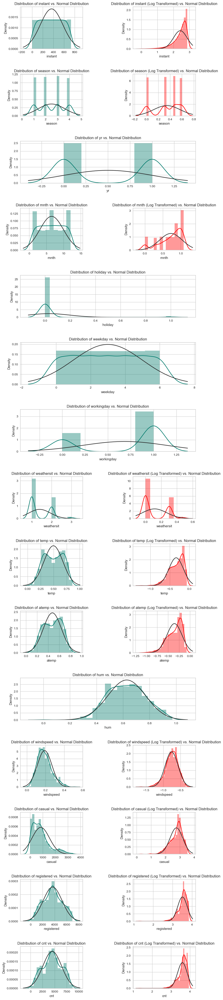

In [16]:
columns = day_df.columns


Grid_plot = plt.GridSpec(len(columns)+1, 2, wspace = 0.8, hspace = 0.6, )

for i, column in enumerate(columns, 0):
    # print('-'*50, f'{column}', '-'*50)
    if any(day_df[column] == 0):
        plt.subplot(Grid_plot[i, : ])
    else:
        plt.subplot(Grid_plot[i, 0])
    g =sns.distplot(day_df[column], 
                 kde=True, 
                 fit=norm,
                 color='#00796b',)
    g.figure.set_figwidth(10)
    g.figure.set_figheight(60) 
    plt.title(f'Distribution of {column} vs. Normal Distribution')
    plt.xlabel(column)
    plt.ylabel('Density')
    # plt.show();

    if not any(day_df[column] == 0):
        plt.subplot(Grid_plot[i, 1])
        sns.distplot(np.log10(day_df[column]), 
                     kde=True, 
                     fit=norm,
                     color='red',)
        
        plt.title(f'Distribution of {column} (Log Transformed) vs. Normal Distribution')
        plt.xlabel(column)
        plt.ylabel('Density')
        
plt.show();

In [17]:
report = sv.analyze([day_df, 'Train'], target_feat='cnt')

                                             |                                             | [  0%]   00:00 ->…


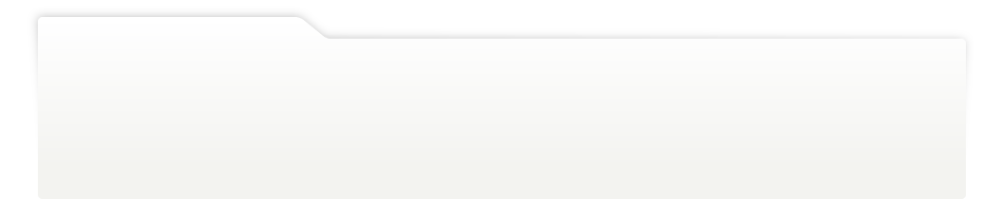
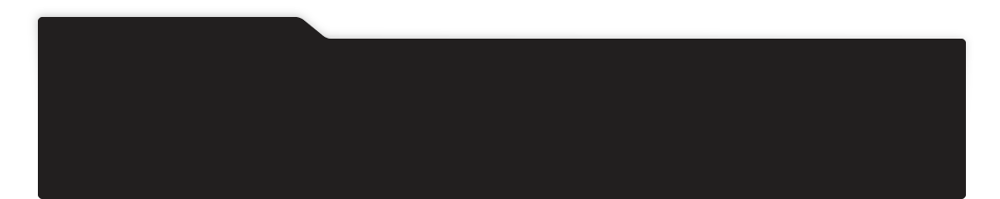
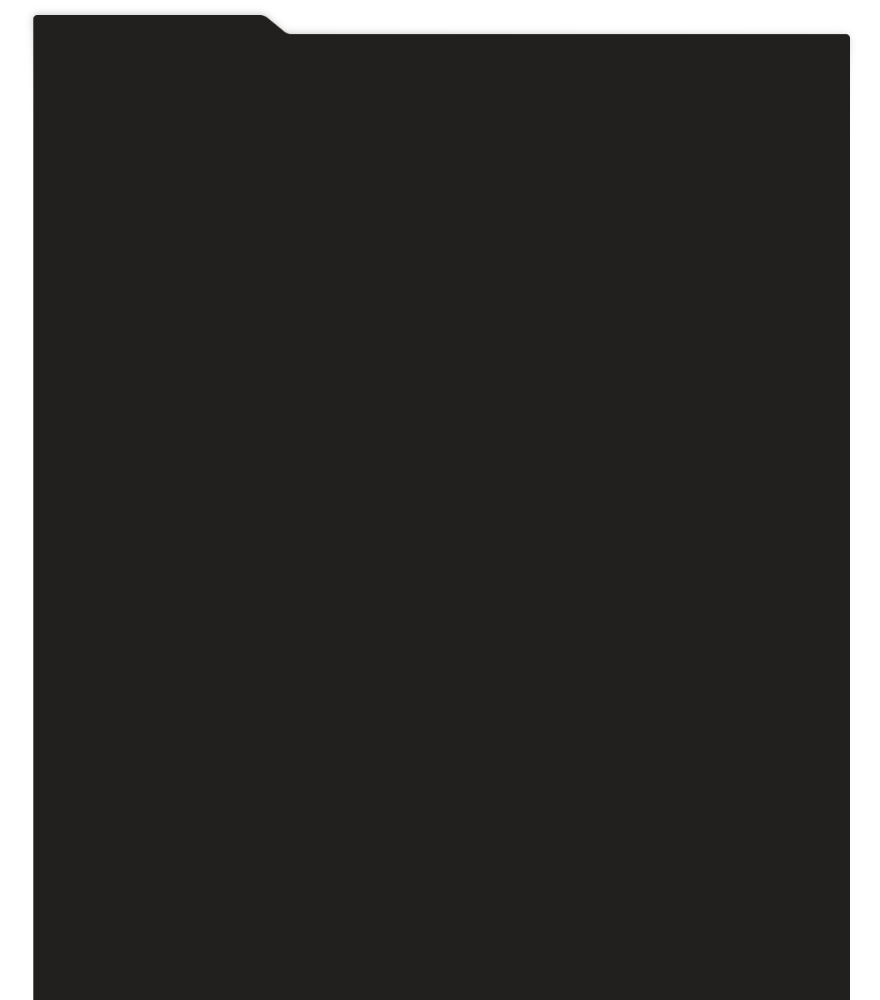
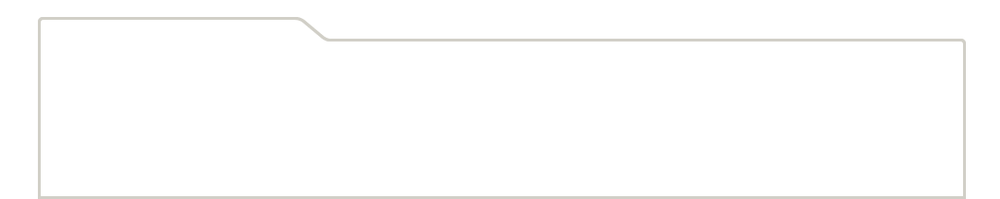
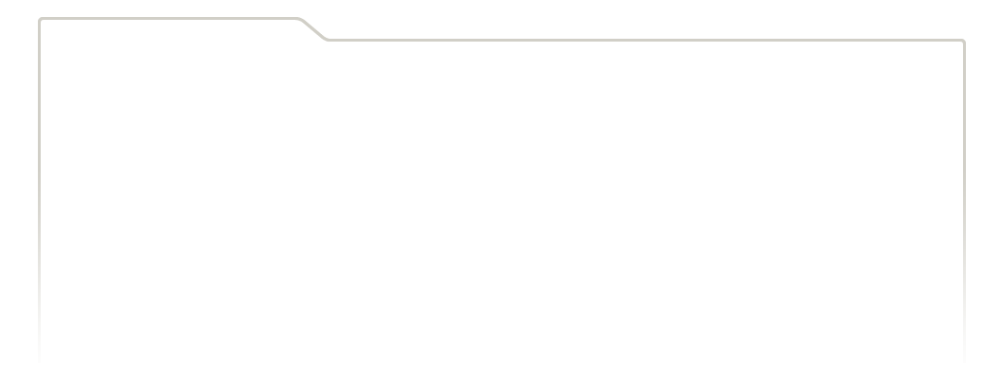
...
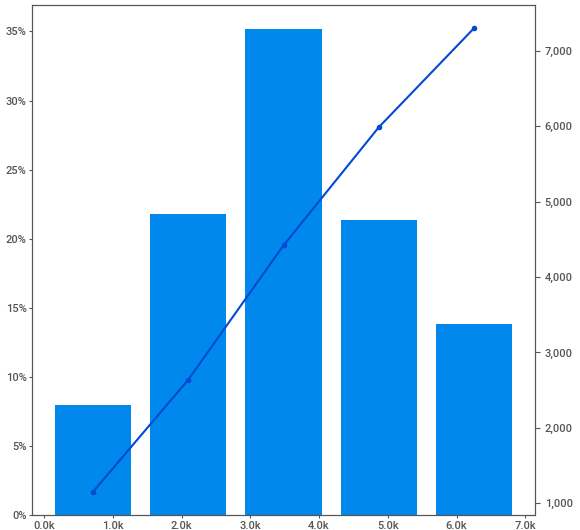
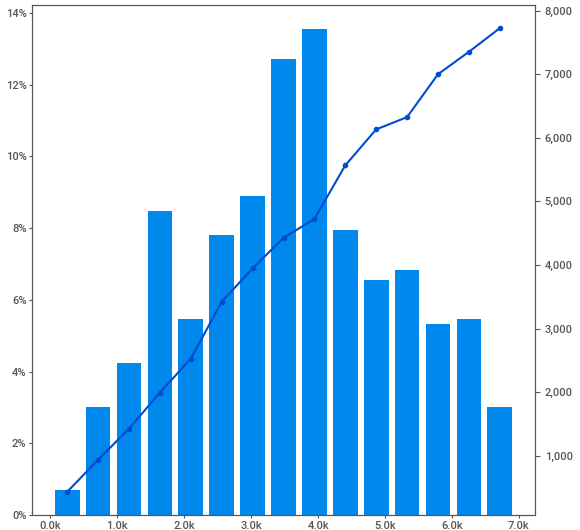
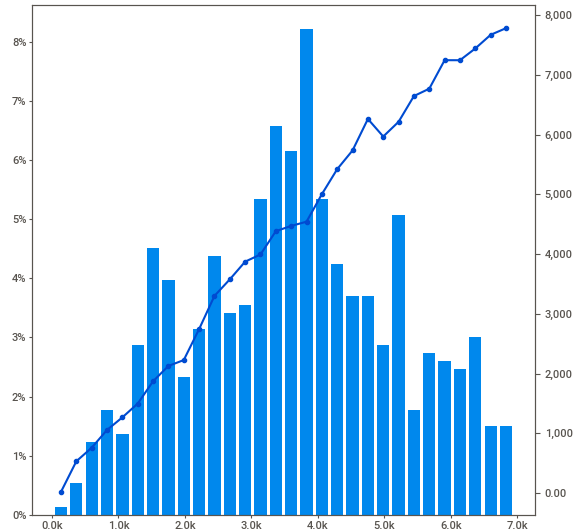
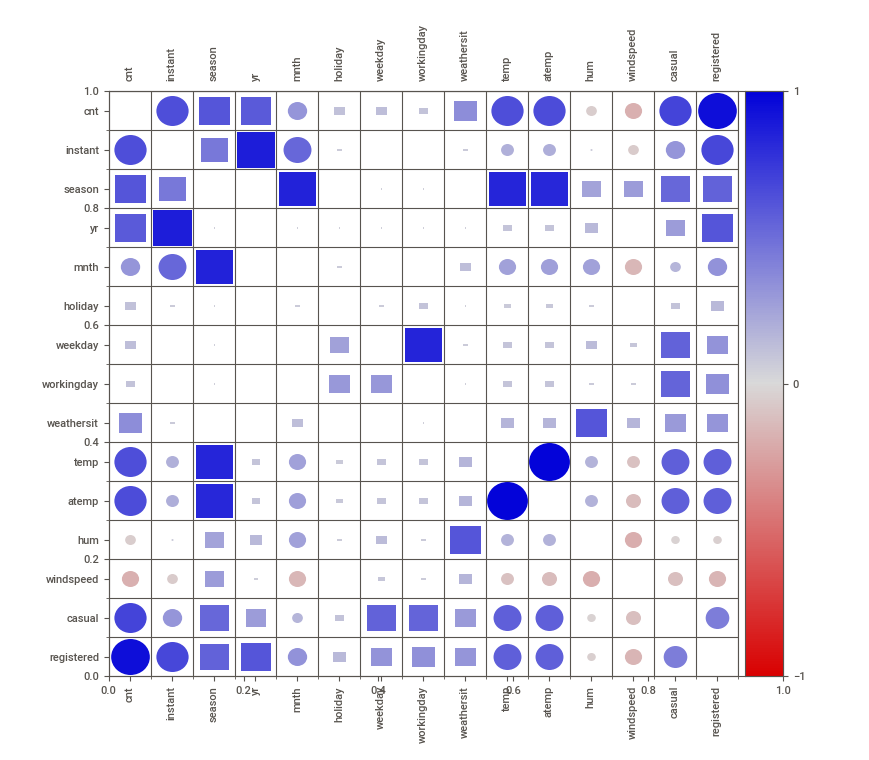
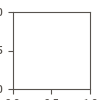

In [18]:
# report.show_html('Report.html')
report.show_notebook()

interval columns not set, guessing: ['instant', 'season', 'yr', 'mnth', 'holiday', 'weekday', 'workingday', 'weathersit', 'temp', 'atemp', 'hum', 'windspeed', 'casual', 'registered', 'cnt']


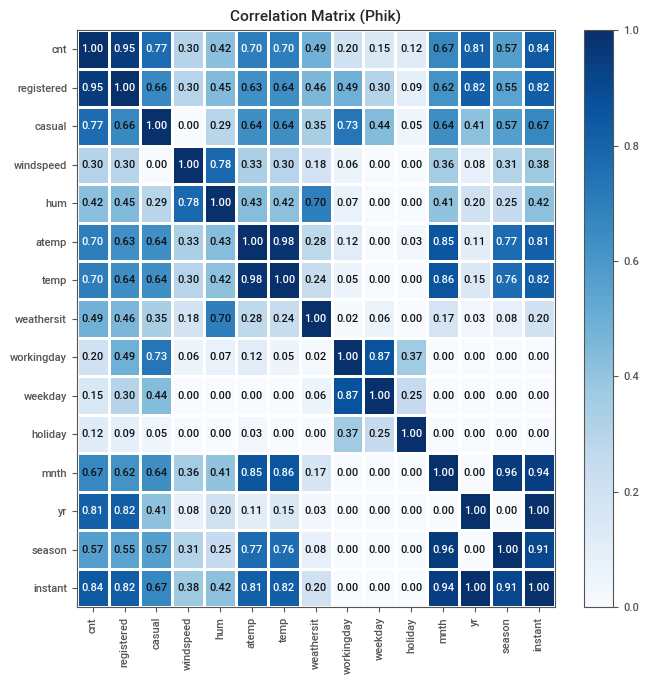

In [19]:
corr_matrix = day_df.phik_matrix()

plot_correlation_matrix(corr_matrix.values,
                        x_labels=corr_matrix.columns,
                        y_labels=corr_matrix.index,
                        vmin=0,
                        vmax=1,
                        color_map="Blues",
                        title="Correlation Matrix (Phik)",
                        fontsize_factor=0.8,
                        figsize=(7,7))

In [20]:
robust_scaler = RobustScaler()

numerical_features = day_df.drop(columns=['instant'], axis=1).columns

raw_data_outliers = day_df.copy()

raw_data_outliers[numerical_features] = robust_scaler.fit_transform(raw_data_outliers[numerical_features])

def count_outliers(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return ((series < lower_bound) | (series > upper_bound)).sum()

for feature in numerical_features :
    num_outliers = count_outliers(raw_data_outliers[feature])
    print(f'Number of outliers in {feature:<15}: {num_outliers:<7} | {(num_outliers/len(raw_data_outliers))*100:<5.02f} %')


Number of outliers in season         : 0       | 0.00  %
Number of outliers in yr             : 0       | 0.00  %
Number of outliers in mnth           : 0       | 0.00  %
Number of outliers in holiday        : 21      | 2.87  %
Number of outliers in weekday        : 0       | 0.00  %
Number of outliers in workingday     : 0       | 0.00  %
Number of outliers in weathersit     : 0       | 0.00  %
Number of outliers in temp           : 0       | 0.00  %
Number of outliers in atemp          : 0       | 0.00  %
Number of outliers in hum            : 2       | 0.27  %
Number of outliers in windspeed      : 13      | 1.78  %
Number of outliers in casual         : 44      | 6.02  %
Number of outliers in registered     : 0       | 0.00  %
Number of outliers in cnt            : 0       | 0.00  %


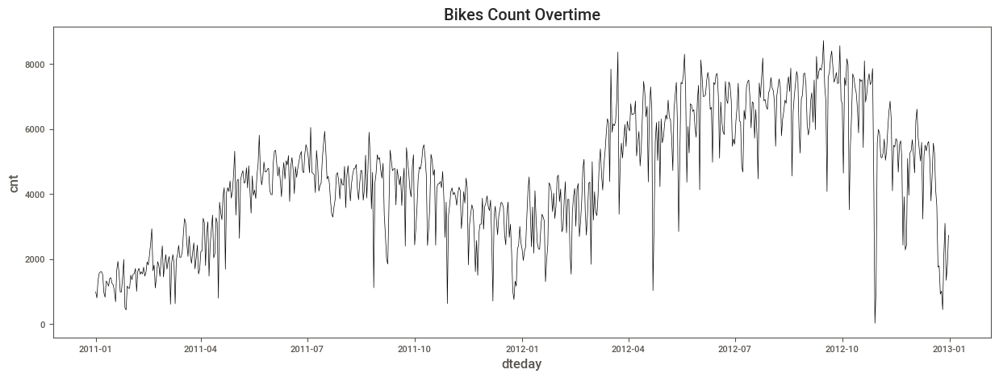

In [21]:
# PLOTTING THE CNT CHANGE OVERTIME
plt.figure(figsize=(15,5))
plt.title('Bikes Count Overtime')
sns.lineplot(day_df.cnt, color='black', linewidth=0.5)
plt.show();

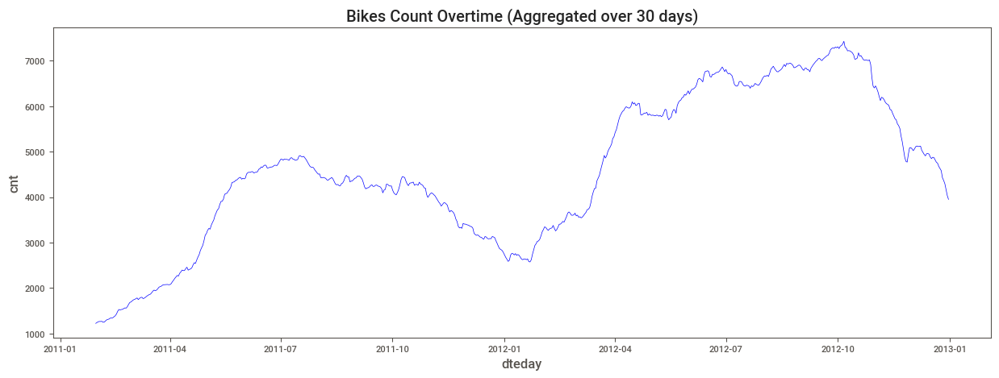

In [22]:
# PLOTTING THE CNT CHANGE OVERTIME
plt.figure(figsize=(15,5))
plt.title('Bikes Count Overtime (Aggregated over 30 days)')
sns.lineplot(day_df.cnt.rolling(window=30).mean(), color='blue', linewidth=0.5)
plt.show();

The most straightforward way to detect multicollinearity in a regression model is by calculating a metric known as the variance inflation factor, often abbreviated VIF.

VIF measures the strength of correlation between predictor variables in a model. It takes on a value between 1 and positive infinity.

We use the following rules of thumb for interpreting VIF values:

VIF = 1: There is no correlation between a given predictor variable and any other predictor variables in the  
odel.
VIF between 1 and 5: There is moderate correlation between a given predictor variable and other predictor variables in the 
model.
VIF > 5: There is severe correlation between a given predictor variable and other predictor variables in the model.

In [23]:
# the independent variables set 
X = day_df.copy(deep=True)
  
# VIF dataframe 
vif_data = pd.DataFrame() 
vif_data["feature"] = X.columns 

# calculating VIF for each feature 
# vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(len(X.columns))]
vif_data_temp = []
for i in range(len(X.columns)):
    try:
        vif_data_temp.append(variance_inflation_factor(X.values, i))
    except FloatingPointError:
        vif_data_temp.append(0)
vif_data["VIF"] = vif_data_temp
vif_data.sort_values(by='VIF', ascending=False).style.background_gradient(axis=0, cmap='YlOrRd')

,feature,VIF
0,instant,2206.726158
2,yr,843.438636
3,mnth,640.345526
9,atemp,579.043435
8,temp,500.481280
10,hum,28.226270
1,season,24.811676
7,weathersit,14.605775
6,workingday,9.455066
11,windspeed,5.513823


In [24]:
# Eigenvalues: Calculate the eigenvalues of the correlation matrix. If there are one or more eigenvalues close to zero, it suggests multicollinearity.
corr_day = day_df.corr()
w,v = np.linalg.eig(corr_day)
print('E-values:')
ev = pd.DataFrame(w, columns=['E'], index=day_df.columns).sort_values(by='E')
ev.style.background_gradient(axis=0, cmap='YlOrRd')
# print('E-vector', v)

E-values:


,E
cnt,0.000000
registered,0.000850
casual,0.007860
windspeed,0.107060
hum,0.163750
atemp,0.294584
temp,0.321001
weathersit,0.822695
workingday,0.924652
weekday,1.047986


In [25]:
# Condition Number: The condition number of the correlation matrix can also be used to detect multicollinearity. 
# A high condition number (greater than 30) indicates multicollinearity.
cond = np.linalg.cond(corr_day)
print('Condition Number:')
print(cond)

print('dropping the top 5 Eigen Values: ', ev.index.to_list()[1:6]) 
corr_day_dropped = day_df.drop(columns=ev.index.to_list()[1:6], axis=1).corr()
cond = np.linalg.cond(corr_day_dropped)
print('Condition Number:')
print(cond)

# pd.DataFrame(w, columns=['E'], index=day_df.columns).sort_values(by='E').style.background_gradient(axis=0, cmap='YlOrRd')

Condition Number:
3.7998637480620344e+16
dropping the top 5 Eigen Values:  ['registered', 'casual', 'windspeed', 'hum', 'atemp']
Condition Number:
3556.5287815272563


## The null hypothesis of the Dickey-Fuller test is that the time series has a unit root, implying it is non-stationary. Therefore, if the p-value is less than a chosen significance level (e.g., 0.05), we reject the null hypothesis and conclude that the time series is stationary. If the p-value is greater than the significance level, we fail to reject the null hypothesis, indicating that the time series is non-stationary.

In [26]:
# Perform Dickey-Fuller test
result = adfuller(day_df.cnt)

print('Test Statistic:', result[0])
print('p-value:', result[1])
print('Critical Values:', result[4])

# The time series is not stationary, since the test rejected the null hypothesis at a significance level of 0.05

Test Statistic: -1.8774481444374298
p-value: 0.34274344033921944
Critical Values: {'1%': -3.439503230053971, '5%': -2.8655794463678346, '10%': -2.5689210707289982}



Autocorrelation, also known as serial correlation, is a measure of the correlation between observations of a time series at different time lags. It is a critical concept in time series analysis and is often used to identify patterns or dependencies within the data.

Positive autocorrelation indicates that the observations at a particular time point are positively correlated with observations at earlier time points, while negative autocorrelation suggests a negative correlation between observations at different time lags.

Autocorrelation can be calculated using the autocorrelation function (ACF) or the partial autocorrelation function (PACF). The ACF measures the correlation between observations at different lags without considering the effect of intermediate lags, while the PACF measures the correlation between observations at different lags after removing the effects of intermediate lags.

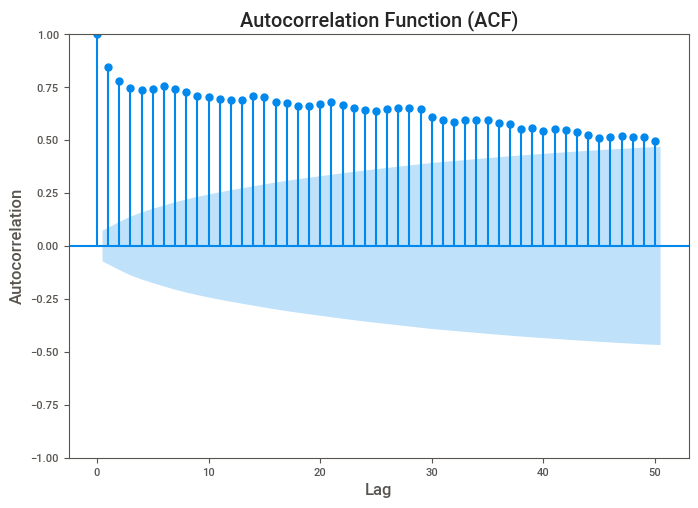

In [27]:
# Plot autocorrelation function (ACF)
LAG = 50
plot_acf(day_df.cnt,lags=LAG)
plt.title('Autocorrelation Function (ACF)')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

# The time series is not white noise. Since on white noise, the data will have approximately zero autocorrelation on all lags except 0

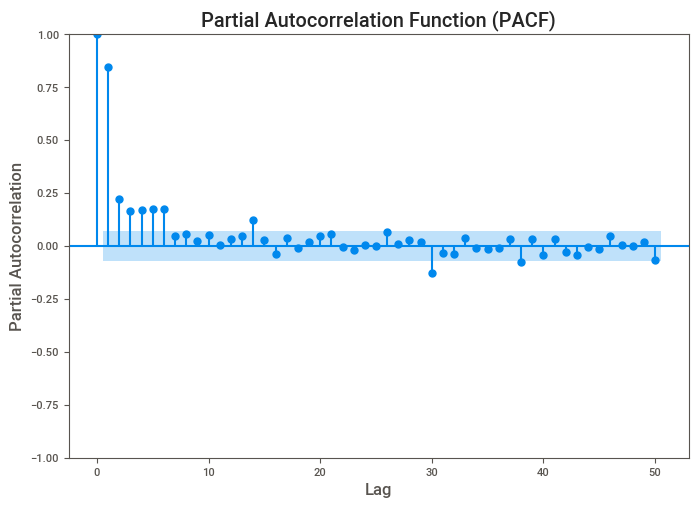

In [28]:
# Plot partial autocorrelation function (PACF)

LAG = 50
plot_pacf(day_df.cnt, lags=LAG)
plt.title('Partial Autocorrelation Function (PACF)')
plt.xlabel('Lag')
plt.ylabel('Partial Autocorrelation')
plt.show()

The series is not a random walk. Since after the differentiation of the first order, it should have turned into white noise and on the correlogram, the data should have a remarkably zero autocorrelation on all lags except 0. But we have several lags on which this does not happen. Conclusion: The time series is neither a random walk nor white noise - therefore it can be worked with. But it is desirable to bring it into a stationary form

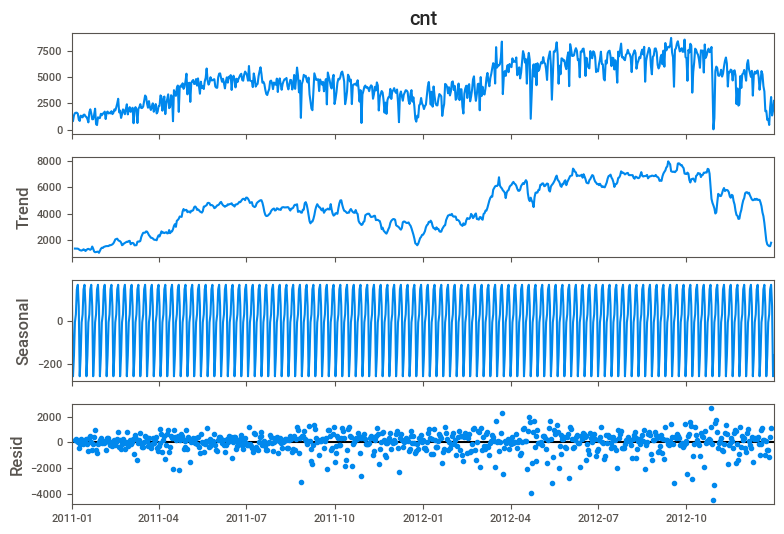

In [29]:
seasonal_decompose(day_df.cnt,model='additive').plot()# multiplicative, additive
plt.show()

The time series does not contain an explicit seasonality. The obvious trend is also not tracked. But despite this, the time series is not stationary

In [30]:
ev.index.to_list()[2:4]

['casual', 'windspeed']

In [31]:
vif_data.feature.loc[1:3].values.tolist()

['season', 'yr', 'mnth']

In [32]:
# create a new column to improve the model
day_df['lag_1'] = day_df.cnt.shift(periods=1) # lag 1
day_df.dropna(inplace=True)
day_df.drop(columns=ev.index.to_list()[2:4], axis=1, inplace=True)
# day_df.drop(columns=['instant'], axis=1, inplace=True)

In [33]:
train  = day_df.iloc[:int(len(day_df)*0.6)]
test = day_df.iloc[int(len(day_df)*0.6):int(len(day_df)*0.9)]
valid = day_df.iloc[int(len(day_df)*0.9):]

X_train = train.drop('cnt',axis=1)
X_test = test.drop('cnt',axis=1)
X_valid = valid.drop('cnt',axis=1)

y_train = train['cnt']
y_test = test['cnt']
y_valid = valid['cnt']

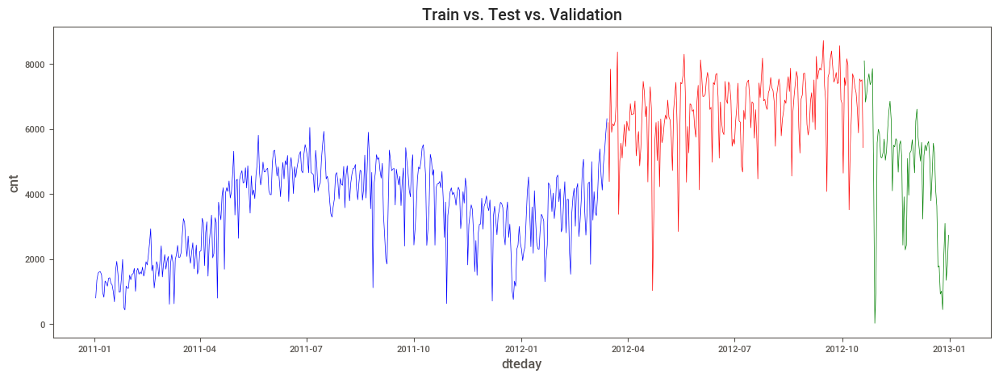

In [34]:
# PLOTTING THE TRAIN VS TEST
plt.figure(figsize=(15,5))
plt.title('Train vs. Test vs. Validation')
sns.lineplot(y_train, color='blue', linewidth=0.5)
sns.lineplot(y_test, color='red', linewidth=0.5)
sns.lineplot(y_valid, color='green', linewidth=0.5)

plt.show();

In [35]:
# LINEAR REGRESSION
lr = LinearRegression()
lr.fit(X_train, y_train)

y_pred_train = pd.Series(lr.predict(X_train), index=y_train.index)

y_pred = lr.predict(X_test)
y_pred = pd.Series(y_pred, index=y_test.index)

y_pred_valid = lr.predict(X_valid)
y_pred_valid = pd.Series(y_pred_valid, index=y_valid.index)

print('R2 on train:', r2_score(y_train, y_pred_train))
print('R2 on test:', r2_score(y_test, y_pred))
print('R2 on validation:', r2_score(y_pred_valid, y_valid))


R2 on train: 0.9577543003349881
R2 on test: 0.7170187124076169
R2 on validation: 0.9368396904924292


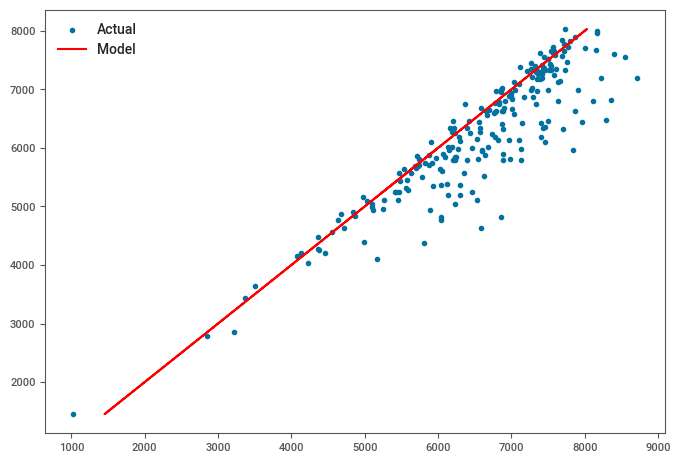

In [36]:
plt.scatter(y_test, y_pred, color='b', label='Actual')
plt.plot(y_pred, y_pred, color='red', label='Model')
plt.legend()
plt.show()

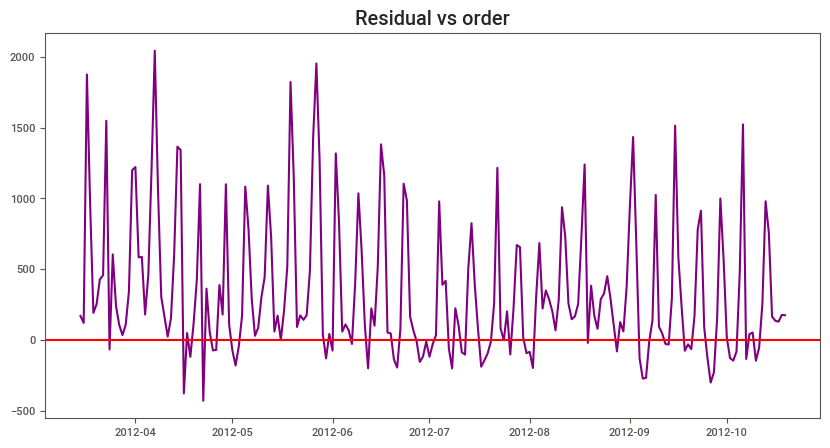

Durbin-Watson Test Statistic: 0.8168740978708228


In [37]:
# error vs order plot (Residual vs order) as a fast check 
plt.figure(figsize=(10, 5))
plt.title('Residual vs order')
plt.plot(y_pred.index, y_test-y_pred, color='purple')
plt.axhline(y=0, color='red')
plt.show()
# Method 2: Durbin Watson Test
# Check the Durbin Watson Statistic
# Rule of thumb: test statistic value in the range of 1.5 to 2.5 are relatively normal
durbin_watson_statistic = sm.stats.stattools.durbin_watson(y_test-y_pred)

print("Durbin-Watson Test Statistic:", durbin_watson_statistic)

Here's how to interpret the Durbin-Watson test statistic:

If d is close to 2, there is no evidence of autocorrelation.

If d is significantly less than 2, it suggests positive autocorrelation (residuals tend to be positively correlated).

If d is significantly greater than 2, it suggests negative autocorrelation (residuals tend to be negatively correlated).

 In a residual plot, if the residuals are randomly scattered around zero with no discernible pattern, it suggests that a linear model is appropriate. However, if there is a clear pattern (e.g., curvature), it indicates that a linear model may not adequately capture the relationship between the variables, and a nonlinear model may be more appropriate.

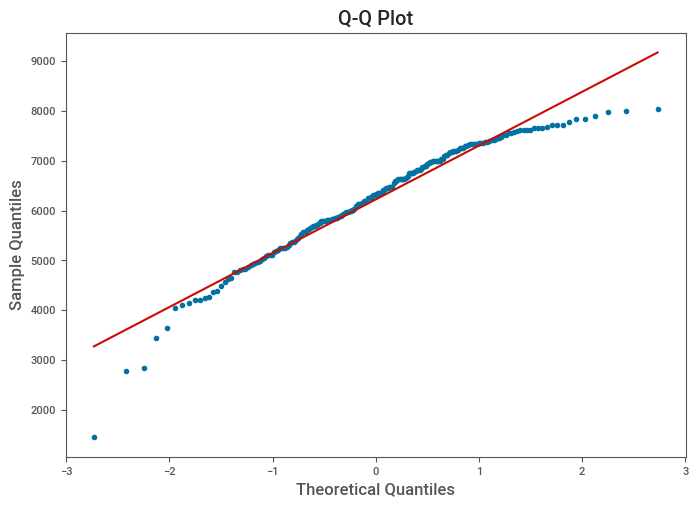

In [38]:
#Checking Normality

# z = (y_test-y_pred - y_test-y_pred.mean())/(y_test-y_pred).std(ddof=1)

# stats.probplot(z, dist='norm', plot=plt)
# plt.title('Normal Q-Q plot')
# plt.show()

# Create Q-Q plot
stats.probplot(y_pred, dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.xlabel('Theoretical Quantiles')
plt.ylabel('Sample Quantiles')
plt.show()


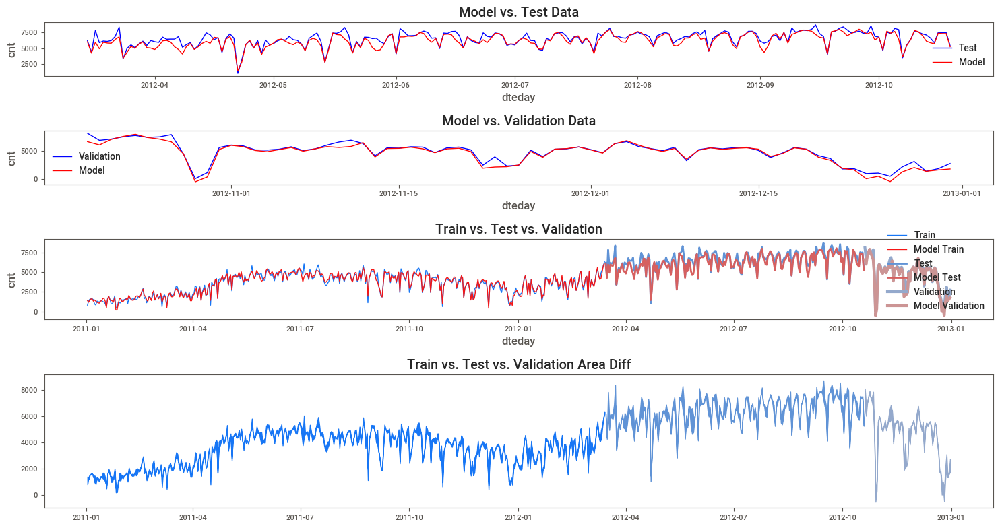

In [39]:
#define plotting region (1 row, 2 columns)
fig, axes = plt.subplots(4, 1, sharex=False, figsize=(15, 8), gridspec_kw={'height_ratios': [2, 2, 3, 5]})

# #create boxplot in each subplot
# sns.violinplot(data=df, x='team', y='points', )
# sns.violinplot(data=df, x='team', y='assists', )

# plt.figure(figsize=(15,5))
axes[0].set_title('Model vs. Test Data')
sns.lineplot(y_test, label='Test', color='blue', linewidth=1, ax=axes[0])
sns.lineplot(y_pred, label='Model', color='red', linewidth=1, ax=axes[0])
# plt.legend()

axes[1].set_title('Model vs. Validation Data')
sns.lineplot(y_valid, label='Validation', color='blue', linewidth=1, ax=axes[1])
sns.lineplot(y_pred_valid, label='Model', color='red', linewidth=1, ax=axes[1])

axes[2].set_title('Train vs. Test vs. Validation')

sns.lineplot(y_train, label='Train', color='#1776F5', linewidth=1, ax=axes[2])
sns.lineplot(y_pred_train, label='Model Train', color='#F51616', linewidth=1, ax=axes[2])

sns.lineplot(y_test, label='Test', color='#6093D6', linewidth=2, ax=axes[2])
sns.lineplot(y_pred, label='Model Test', color='#D66060', linewidth=2, ax=axes[2])

sns.lineplot(y_valid, label='Validation', color='#94A9CC', linewidth=3, ax=axes[2])
sns.lineplot(y_pred_valid, label='Model Validation', color='#CC9595', linewidth=3, ax=axes[2])

axes[3].set_title('Train vs. Test vs. Validation Area Diff')

axes[3].fill_between(y_train.index, y_train, y_pred_train, label='Train', color='#1776F5')

axes[3].fill_between(y_test.index, y_test, y_pred, label='Test', color='#6093D6')

axes[3].fill_between(y_valid.index, y_valid, y_pred_valid, label='Validation', color='#94A9CC')
# plt.legend()
fig.tight_layout()
plt.show();

In [40]:
scores = cross_val_score(lr, X_train, y_train, cv=10)
print("Average CV accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Average CV accuracy: 0.74 (+/- 0.53)


In [41]:
# SVR
regressorSVR = SVR(kernel='linear')
regressorSVR.fit(X_train, y_train)
#predicting the results and reversing the scaling
#sc_y.inverse_transform(regressor.predict(sc_X.transform([[6.5]])))
y_pred_train = pd.Series(regressorSVR.predict(X_train), index=y_train.index)

y_pred = regressorSVR.predict(X_test)
y_pred = pd.Series(y_pred, index=y_test.index)

y_pred_valid = regressorSVR.predict(X_valid)
y_pred_valid = pd.Series(y_pred_valid, index=y_valid.index)

print('R2 on train:', r2_score(y_train, y_pred_train))
print('R2 on test:', r2_score(y_test, y_pred))
print('R2 on validation:', r2_score(y_pred_valid, y_valid))

scores = cross_val_score(regressorSVR, X_train, y_train, cv=10)
print("Average accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

R2 on train: 0.8944510480445593
R2 on test: 0.4195302677556565
R2 on validation: 0.9159191568785222
Average accuracy: 0.56 (+/- 0.84)


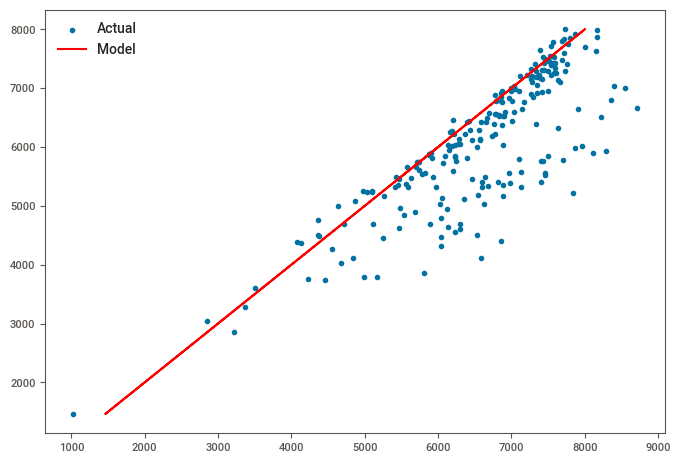

In [42]:
plt.scatter(y_test, y_pred, color='b', label='Actual')
plt.plot(y_pred, y_pred, color='red', label='Model')
plt.legend()
plt.show()

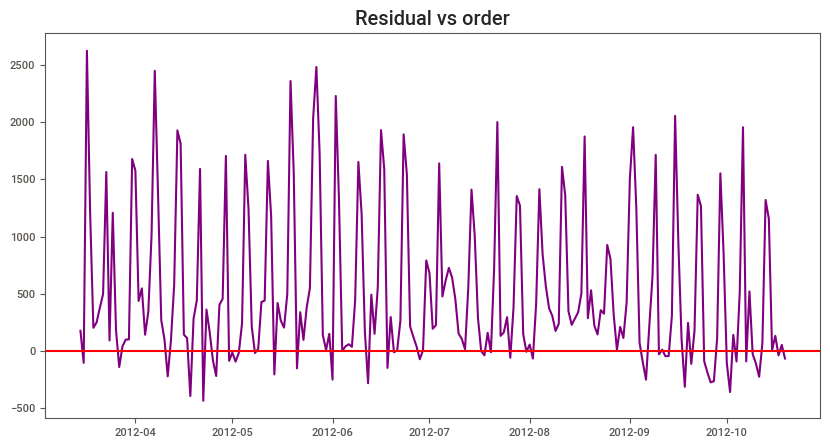

Durbin-Watson Test Statistic: 0.8827440298393366


In [43]:
# error vs order plot (Residual vs order) as a fast check 
plt.figure(figsize=(10, 5))
plt.title('Residual vs order')
plt.plot(y_pred.index, y_test-y_pred, color='purple')
plt.axhline(y=0, color='red')
plt.show()
# Method 2: Durbin Watson Test
# Check the Durbin Watson Statistic
# Rule of thumb: test statistic value in the range of 1.5 to 2.5 are relatively normal
durbin_watson_statistic = sm.stats.stattools.durbin_watson(y_test-y_pred)

print("Durbin-Watson Test Statistic:", durbin_watson_statistic)

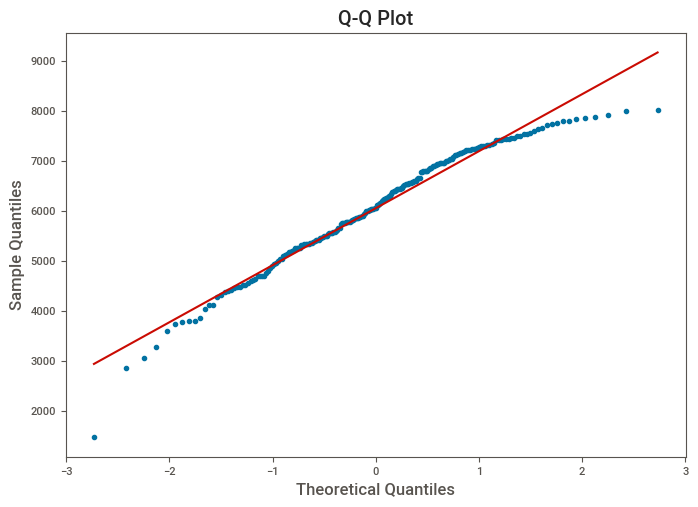

In [44]:
#Checking Normality

# z = (y_test-y_pred - y_test-y_pred.mean())/(y_test-y_pred).std(ddof=1)

# stats.probplot(z, dist='norm', plot=plt)
# plt.title('Normal Q-Q plot')
# plt.show()

# Create Q-Q plot
stats.probplot(y_pred, dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.xlabel('Theoretical Quantiles')
plt.ylabel('Sample Quantiles')
plt.show()


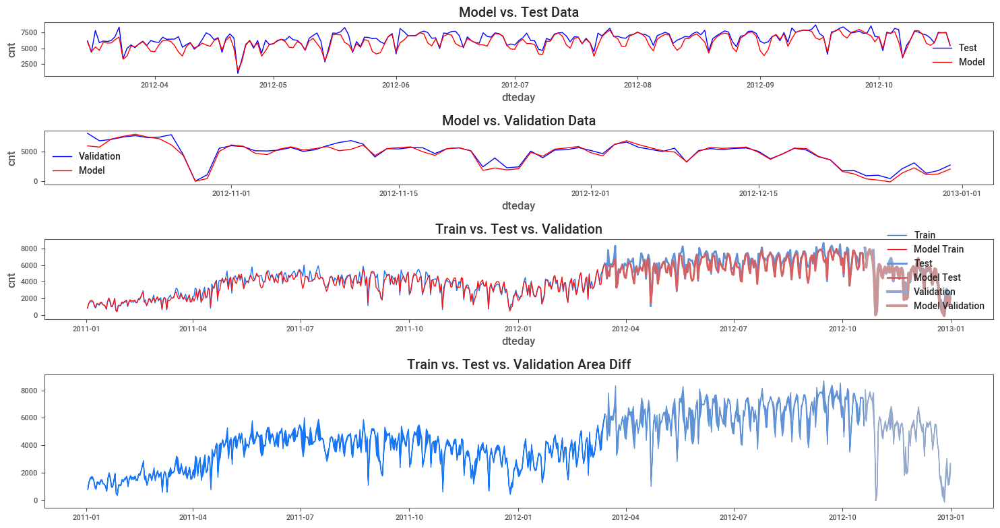

In [45]:
#define plotting region (1 row, 2 columns)
fig, axes = plt.subplots(4, 1, sharex=False, figsize=(15, 8), gridspec_kw={'height_ratios': [2, 2, 3, 5]})

# #create boxplot in each subplot
# sns.violinplot(data=df, x='team', y='points', )
# sns.violinplot(data=df, x='team', y='assists', )

# plt.figure(figsize=(15,5))
axes[0].set_title('Model vs. Test Data')
sns.lineplot(y_test, label='Test', color='blue', linewidth=1, ax=axes[0])
sns.lineplot(y_pred, label='Model', color='red', linewidth=1, ax=axes[0])
# plt.legend()

axes[1].set_title('Model vs. Validation Data')
sns.lineplot(y_valid, label='Validation', color='blue', linewidth=1, ax=axes[1])
sns.lineplot(y_pred_valid, label='Model', color='red', linewidth=1, ax=axes[1])

axes[2].set_title('Train vs. Test vs. Validation')

sns.lineplot(y_train, label='Train', color='#1776F5', linewidth=1, ax=axes[2])
sns.lineplot(y_pred_train, label='Model Train', color='#F51616', linewidth=1, ax=axes[2])

sns.lineplot(y_test, label='Test', color='#6093D6', linewidth=2, ax=axes[2])
sns.lineplot(y_pred, label='Model Test', color='#D66060', linewidth=2, ax=axes[2])

sns.lineplot(y_valid, label='Validation', color='#94A9CC', linewidth=3, ax=axes[2])
sns.lineplot(y_pred_valid, label='Model Validation', color='#CC9595', linewidth=3, ax=axes[2])

axes[3].set_title('Train vs. Test vs. Validation Area Diff')

axes[3].fill_between(y_train.index, y_train, y_pred_train, label='Train', color='#1776F5')

axes[3].fill_between(y_test.index, y_test, y_pred, label='Test', color='#6093D6')

axes[3].fill_between(y_valid.index, y_valid, y_pred_valid, label='Validation', color='#94A9CC')
# plt.legend()
fig.tight_layout()
plt.show();

In [46]:
# MLP
mlp = MLPRegressor(random_state=0, max_iter=1_000, hidden_layer_sizes=(100,)).fit(X_train, y_train)

y_pred_train = pd.Series(mlp.predict(X_train), index=y_train.index)

y_pred = mlp.predict(X_test)
y_pred = pd.Series(y_pred, index=y_test.index)

y_pred_valid = mlp.predict(X_valid)
y_pred_valid = pd.Series(y_pred_valid, index=y_valid.index)

print('R2 on train:', r2_score(y_train, y_pred_train))
print('R2 on test:', r2_score(y_test, y_pred))
print('R2 on validation:', r2_score(y_pred_valid, y_valid))

scores = cross_val_score(mlp, X_train, y_train, cv=10)
print("Average CV accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

R2 on train: 0.9173760866804346
R2 on test: 0.5894459704684436
R2 on validation: 0.9285546465354537
Average CV accuracy: 0.66 (+/- 0.45)


In [47]:
# Huber Regressor
HBR = HuberRegressor().fit(X_train, y_train)

y_pred_train = pd.Series(HBR.predict(X_train), index=y_train.index)

y_pred = HBR.predict(X_test)
y_pred = pd.Series(y_pred, index=y_test.index)

y_pred_valid = HBR.predict(X_valid)
y_pred_valid = pd.Series(y_pred_valid, index=y_valid.index)

print('R2 on train:', r2_score(y_train, y_pred_train))
print('R2 on test:', r2_score(y_test, y_pred))
print('R2 on validation:', r2_score(y_pred_valid, y_valid))

scores = cross_val_score(regressorSVR, X_train, y_train, cv=10)
print("Average accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

R2 on train: 0.9159388852174871
R2 on test: 0.59605038123218
R2 on validation: 0.9300531665763904
Average accuracy: 0.56 (+/- 0.84)


## FEATURES ENGINEERING

In [48]:
# create a new column to improve the model
day_df_original.drop(columns=['instant'], axis=1, inplace=True)

day_df = day_df_original.copy(deep=True)

day_df['lag_1'] = day_df.cnt.shift(periods=1) # lag 1
day_df.dropna(inplace=True)

# day_df['sin_season'] = np.sin(day_df['season'] * 2 * np.pi / 4)
day_df['cos_season'] = np.cos(day_df['season'] * 2 * np.pi / 4)

# std = StandardScaler()
std = MinMaxScaler()

day_df = pd.DataFrame(std.fit_transform(day_df), columns=day_df.columns.to_list(), index=day_df.index.to_list())
day_df.drop(columns=['hum', 'atemp', 'season', 'weekday', 'holiday'], axis=1, inplace=True)
day_df.drop(columns=ev.index.to_list()[2:4], axis=1, inplace=True)

In [49]:
train  = day_df.iloc[:int(len(day_df)*0.6)]
test = day_df.iloc[int(len(day_df)*0.6):int(len(day_df)*0.9)]
valid = day_df.iloc[int(len(day_df)*0.9):]

X_train = train.drop('cnt',axis=1)
X_test = test.drop('cnt',axis=1)
X_valid = valid.drop('cnt',axis=1)

y_train = train['cnt']
y_test = test['cnt']
y_valid = valid['cnt']

In [50]:
# LINEAR REGRESSION
lr = LinearRegression()
lr.fit(X_train, y_train)

y_pred_train = pd.Series(lr.predict(X_train), index=y_train.index)

y_pred = lr.predict(X_test)
y_pred = pd.Series(y_pred, index=y_test.index)

y_pred_valid = lr.predict(X_valid)
y_pred_valid = pd.Series(y_pred_valid, index=y_valid.index)

print('R2 on train:', r2_score(y_train, y_pred_train))
print('R2 on test:', r2_score(y_test, y_pred))
print('R2 on validation:', r2_score(y_pred_valid, y_valid))

scores = cross_val_score(lr, X_train, y_train, cv=10)
print("Average CV accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

R2 on train: 0.9574780877684956
R2 on test: 0.7328725592617252
R2 on validation: 0.9407038910424261
Average CV accuracy: 0.76 (+/- 0.48)


In [51]:
params = np.append(lr.intercept_, lr.coef_)
predictions = lr.predict(X_train)

# newX = pd.DataFrame({"Constant":np.ones(len(X_train))}).join(pd.DataFrame(X_train))
# MSE = (sum((y_train-predictions)**2))/(len(newX)-len(newX.columns))

newX = np.append(np.ones((len(X_train),1)), X_train, axis=1)
MSE = (sum((y_train-predictions)**2))/(len(newX)-len(newX[0]))

# Note if you don't want to use a DataFrame replace the two lines above with
# newX = np.append(np.ones((len(X),1)), X, axis=1)
# MSE = (sum((y-predictions)**2))/(len(newX)-len(newX[0]))

var_b = MSE*(np.linalg.inv(np.dot(newX.T,newX)).diagonal())
sd_b = np.sqrt(var_b)
ts_b = params/ sd_b

p_values =[2*(1-stats.t.cdf(np.abs(i),(len(newX)-len(newX[0])))) for i in ts_b]

sd_b = np.round(sd_b,3)
ts_b = np.round(ts_b,3)
p_values = np.round(p_values,3)
params = np.round(params,4)

columns = X_train.columns.to_list()
columns.insert(0, 'constant')


myDF3 = pd.DataFrame(index=columns)
myDF3["Coefficients"], myDF3["Standard Errors"], myDF3["t values"], myDF3["Probabilities"] = [params,sd_b,ts_b,p_values]

myDF3.sort_values(by='Probabilities').style.background_gradient(axis=0, cmap='YlOrRd')

,Coefficients,Standard Errors,t values,Probabilities
constant,0.039400,0.006000,6.647000,0.000000
yr,-0.038900,0.007000,-5.823000,0.000000
workingday,-0.084600,0.004000,-20.673000,0.000000
temp,0.080200,0.012000,6.724000,0.000000
registered,0.926400,0.021000,43.239000,0.000000
lag_1,0.056600,0.018000,3.097000,0.002000
weathersit,-0.018000,0.006000,-2.897000,0.004000
mnth,-0.020300,0.009000,-2.333000,0.020000
cos_season,-0.010200,0.007000,-1.488000,0.138000


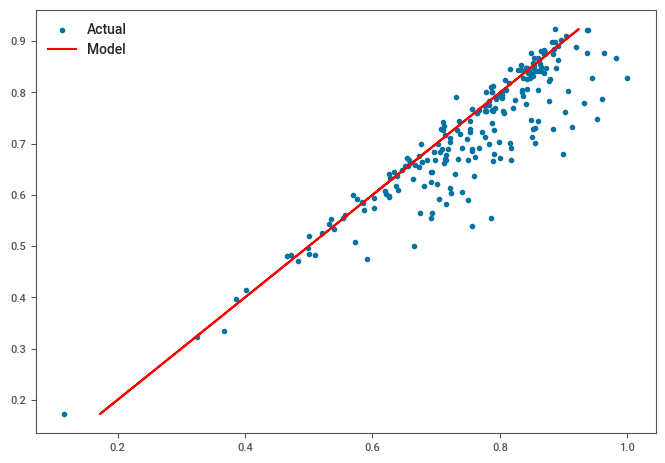

In [52]:
plt.scatter(y_test, y_pred, color='b', label='Actual')
plt.plot(y_pred, y_pred, color='red', label='Model')
plt.legend()
plt.show()

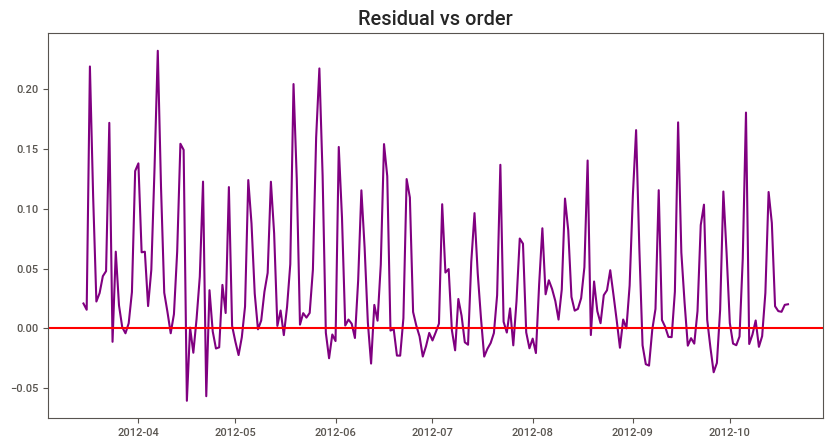

Durbin-Watson Test Statistic: 0.8838115573756368


In [53]:
# error vs order plot (Residual vs order) as a fast check 
plt.figure(figsize=(10, 5))
plt.title('Residual vs order')
plt.plot(y_pred.index, y_test-y_pred, color='purple')
plt.axhline(y=0, color='red')
plt.show()
# Method 2: Durbin Watson Test
# Check the Durbin Watson Statistic
# Rule of thumb: test statistic value in the range of 1.5 to 2.5 are relatively normal
durbin_watson_statistic = sm.stats.stattools.durbin_watson(y_test-y_pred)

print("Durbin-Watson Test Statistic:", durbin_watson_statistic)

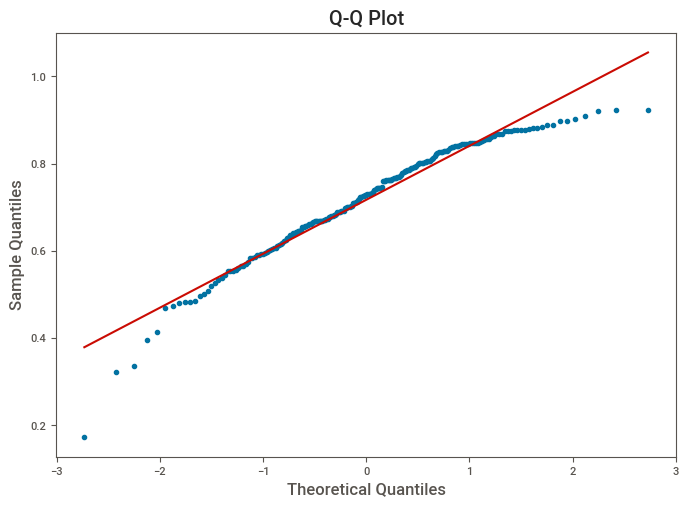

In [54]:
#Checking Normality

# z = (y_test-y_pred - y_test-y_pred.mean())/(y_test-y_pred).std(ddof=1)

# stats.probplot(z, dist='norm', plot=plt)
# plt.title('Normal Q-Q plot')
# plt.show()

# Create Q-Q plot
stats.probplot(y_pred, dist="norm", plot=plt)
plt.title('Q-Q Plot')
plt.xlabel('Theoretical Quantiles')
plt.ylabel('Sample Quantiles')
plt.show()


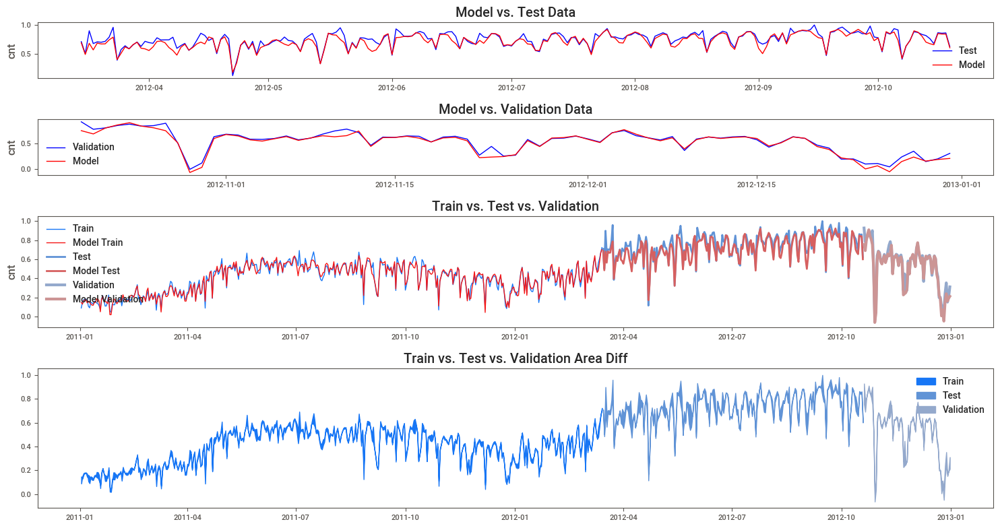

In [55]:
#define plotting region (1 row, 2 columns)
fig, axes = plt.subplots(4, 1, sharex=False, figsize=(15, 8), gridspec_kw={'height_ratios': [2, 2, 4, 5]})

# #create boxplot in each subplot
# sns.violinplot(data=df, x='team', y='points', )
# sns.violinplot(data=df, x='team', y='assists', )

# plt.figure(figsize=(15,5))
axes[0].set_title('Model vs. Test Data')
sns.lineplot(y_test, label='Test', color='blue', linewidth=1, ax=axes[0])
sns.lineplot(y_pred, label='Model', color='red', linewidth=1, ax=axes[0])
# plt.legend()

axes[1].set_title('Model vs. Validation Data')
sns.lineplot(y_valid, label='Validation', color='blue', linewidth=1, ax=axes[1])
sns.lineplot(y_pred_valid, label='Model', color='red', linewidth=1, ax=axes[1])

axes[2].set_title('Train vs. Test vs. Validation')

sns.lineplot(y_train, label='Train', color='#1776F5', linewidth=1, ax=axes[2])
sns.lineplot(y_pred_train, label='Model Train', color='#F51616', linewidth=1, ax=axes[2])

sns.lineplot(y_test, label='Test', color='#6093D6', linewidth=2, ax=axes[2])
sns.lineplot(y_pred, label='Model Test', color='#D66060', linewidth=2, ax=axes[2])

sns.lineplot(y_valid, label='Validation', color='#94A9CC', linewidth=3, ax=axes[2])
sns.lineplot(y_pred_valid, label='Model Validation', color='#CC9595', linewidth=3, ax=axes[2])

axes[3].set_title('Train vs. Test vs. Validation Area Diff')

axes[3].fill_between(y_train.index, y_train, y_pred_train, label='Train', color='#1776F5')

axes[3].fill_between(y_test.index, y_test, y_pred, label='Test', color='#6093D6')

axes[3].fill_between(y_valid.index, y_valid, y_pred_valid, label='Validation', color='#94A9CC')
plt.legend()
fig.tight_layout()
plt.show();

## CLUSTERING

In [56]:
day_df_original.head()

,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
dteday,,,,,,,,,,,,,,
2011-01-01,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985
2011-01-02,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801
2011-01-03,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349
2011-01-04,1,0,1,0,2,1,1,0.200000,0.212122,0.590435,0.160296,108,1454,1562
2011-01-05,1,0,1,0,3,1,1,0.226957,0.229270,0.436957,0.186900,82,1518,1600


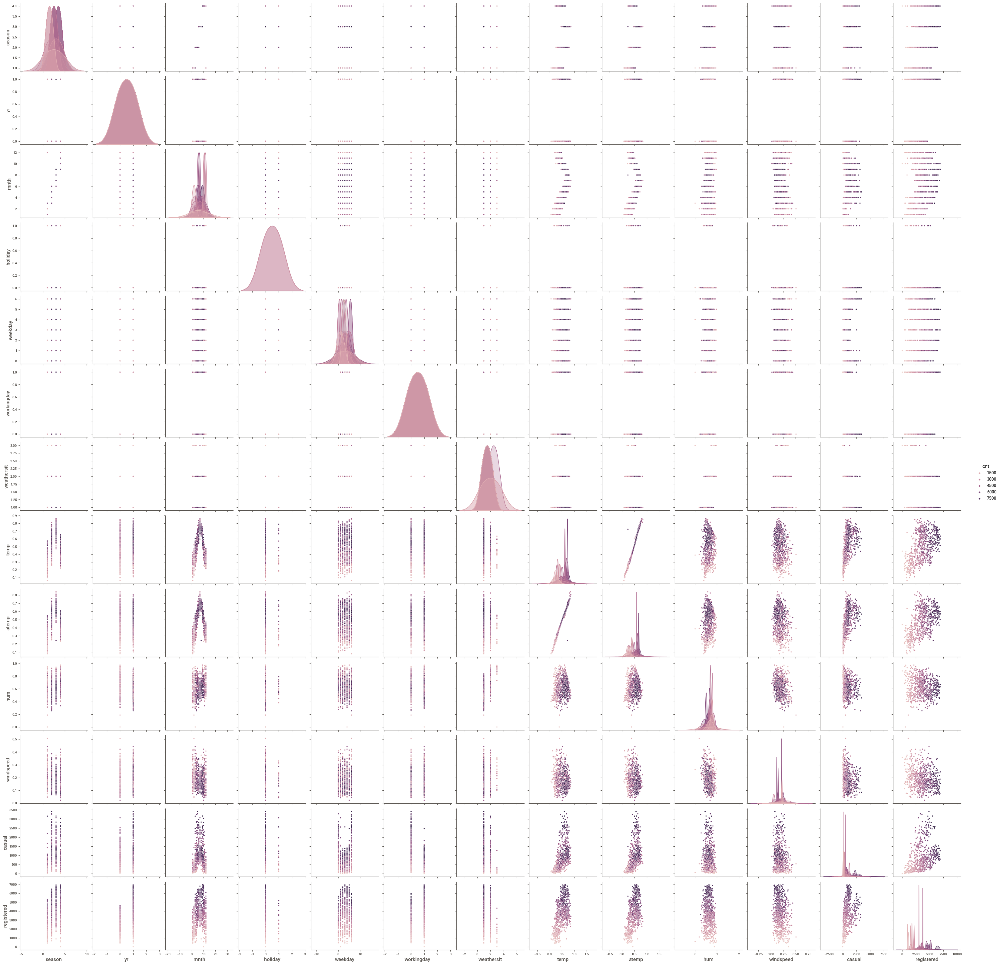

In [57]:
sns.pairplot(day_df_original, hue ='cnt')
plt.show()

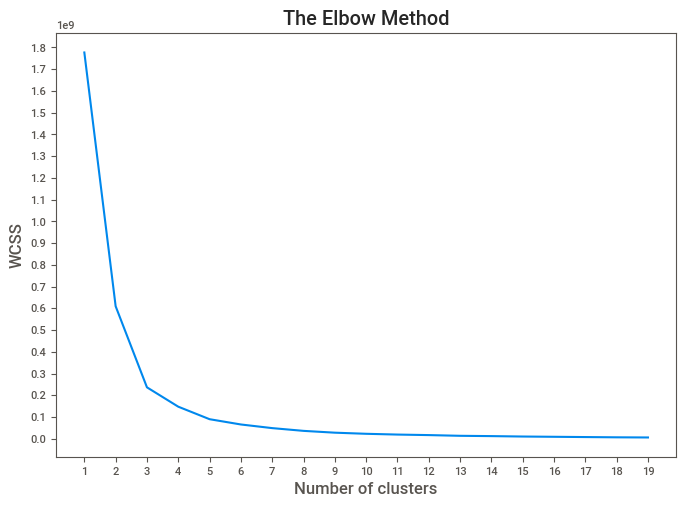

In [58]:
wcss = []
for i in range(1, 20):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 0)
    kmeans.fit(day_df_original[['registered', 'windspeed']])
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 20), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.locator_params(axis='both', nbins=20) 
plt.show()

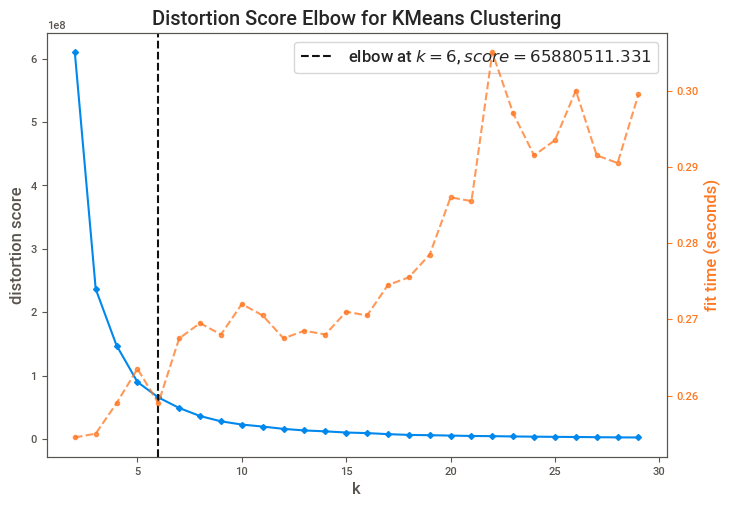

In [59]:
model = KMeans()
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,30), timings= True)
visualizer.fit(day_df_original[['registered', 'windspeed']])        # Fit data to visualizer
visualizer.show();        # Finalize and render figure

In [60]:
for i in range(2, 20):
    # Instantiate the KMeans for 5 clusters
    km = KMeans(n_clusters=i, random_state=0)
    # Fit the KMeans model
    km.fit_predict(day_df_original[['registered', 'windspeed']])
    # Calculate Silhoutte Score
    score = silhouette_score(day_df_original[['registered', 'windspeed']], km.labels_, metric='euclidean')
    # Print the score
    print(f'Silhouetter Average Score for n of Clusters = {i} is: %.3f' % score)

Silhouetter Average Score for n of Clusters = 2 is: 0.540
Silhouetter Average Score for n of Clusters = 3 is: 0.595
Silhouetter Average Score for n of Clusters = 4 is: 0.550
Silhouetter Average Score for n of Clusters = 5 is: 0.563
Silhouetter Average Score for n of Clusters = 6 is: 0.549
Silhouetter Average Score for n of Clusters = 7 is: 0.548
Silhouetter Average Score for n of Clusters = 8 is: 0.556
Silhouetter Average Score for n of Clusters = 9 is: 0.558
Silhouetter Average Score for n of Clusters = 10 is: 0.556
Silhouetter Average Score for n of Clusters = 11 is: 0.560
Silhouetter Average Score for n of Clusters = 12 is: 0.552
Silhouetter Average Score for n of Clusters = 13 is: 0.553
Silhouetter Average Score for n of Clusters = 14 is: 0.549
Silhouetter Average Score for n of Clusters = 15 is: 0.564
Silhouetter Average Score for n of Clusters = 16 is: 0.557
Silhouetter Average Score for n of Clusters = 17 is: 0.565
Silhouetter Average Score for n of Clusters = 18 is: 0.568
Silho

In [61]:
kmeans_3 = KMeans(n_clusters = 3, init = 'k-means++', random_state = 0).fit_predict(day_df_original[['registered', 'windspeed']])
kmeans_2 = KMeans(n_clusters = 2, init = 'k-means++', random_state = 0).fit_predict(day_df_original[['registered', 'windspeed']])

day_df_original['res_3'] = kmeans_3
day_df_original['res_2'] = kmeans_2

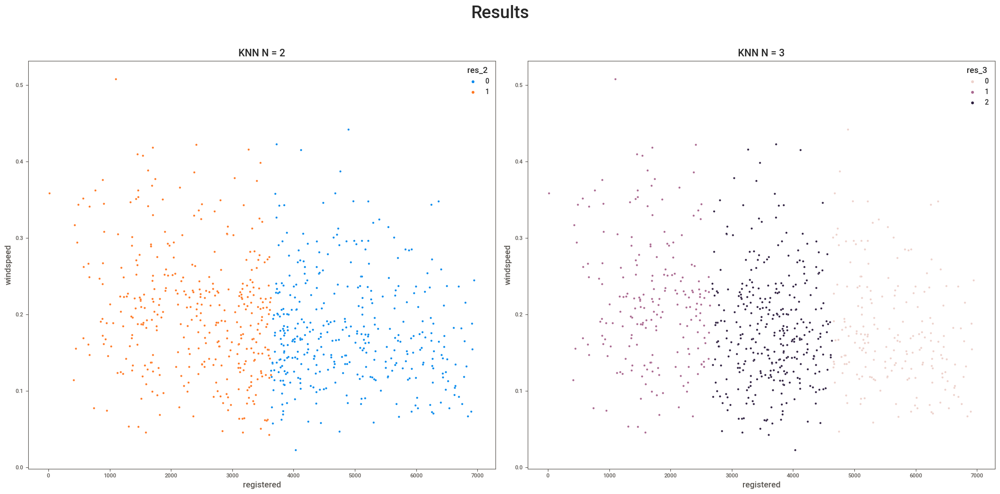

In [62]:
fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(20, 10))
fig.suptitle('Results\n', size = 25)

sns.scatterplot(ax=axes[0], data=day_df_original, x='registered', y='windspeed', hue='res_2').set_title("KNN N = 2")
sns.scatterplot(ax=axes[1], data=day_df_original, x='registered', y='windspeed', hue='res_3').set_title("KNN N = 3")


plt.tight_layout()